Need to have tensorflow, open-cv and tensorflow_datasets installed

In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="-1"  #Ensure Only CPU
import tensorflow as tf
import cv2
import numpy as np
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

# Load Dataset

In [2]:
ds = tfds.load('deep_weeds', batch_size = -1, as_supervised = True)

images, labels = ds['train']

Instructions for updating:
Use `tf.data.Dataset.get_single_element()`.


Instructions for updating:
Use `tf.data.Dataset.get_single_element()`.


In [3]:
#Images are stored as tensors
images[0]

<tf.Tensor: shape=(256, 256, 3), dtype=uint8, numpy=
array([[[200, 213, 230],
        [213, 225, 239],
        [245, 255, 255],
        ...,
        [ 85, 127, 107],
        [ 62,  67,  63],
        [ 77,  65,  67]],

       [[199, 212, 229],
        [224, 236, 250],
        [232, 242, 251],
        ...,
        [ 52,  89,  72],
        [ 61,  66,  62],
        [ 81,  69,  71]],

       [[158, 170, 186],
        [230, 242, 255],
        [247, 255, 255],
        ...,
        [180, 206, 195],
        [123, 125, 122],
        [ 84,  73,  77]],

       ...,

       [[ 33,  36,  43],
        [ 33,  36,  43],
        [ 31,  35,  44],
        ...,
        [186, 192, 206],
        [ 68,  74,  88],
        [ 88,  94, 108]],

       [[ 36,  36,  44],
        [ 33,  36,  43],
        [ 31,  35,  44],
        ...,
        [103, 109, 123],
        [ 94, 100, 114],
        [ 58,  64,  78]],

       [[ 36,  36,  44],
        [ 33,  36,  43],
        [ 32,  35,  44],
        ...,
        [ 26,  32,  4

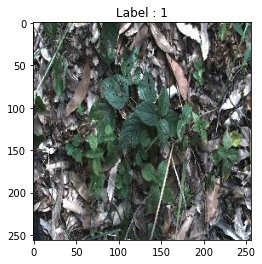

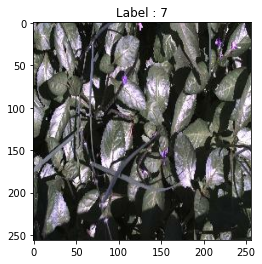

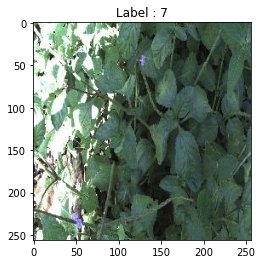

In [4]:
#Check some images
for i in range(3):
    fig , ax = plt.subplots()
    ax.imshow(images[i])
    ax.set_title("Label : " + str(labels[i].numpy()))

In [5]:
img_0 = tf.gather_nd(images, tf.where(labels == 0))
img_1 = tf.gather_nd(images, tf.where(labels == 1))
img_2 = tf.gather_nd(images, tf.where(labels == 2))
img_3 = tf.gather_nd(images, tf.where(labels == 3))
img_4 = tf.gather_nd(images, tf.where(labels == 4))
img_5 = tf.gather_nd(images, tf.where(labels == 5))
img_6 = tf.gather_nd(images, tf.where(labels == 6))
img_7 = tf.gather_nd(images, tf.where(labels == 7))
img_8 = tf.gather_nd(images, tf.where(labels == 8))

img_sorted = [img_0, img_1, img_2, img_3, img_4, img_5, img_6, img_7, img_8]

<Figure size 2880x2880 with 0 Axes>

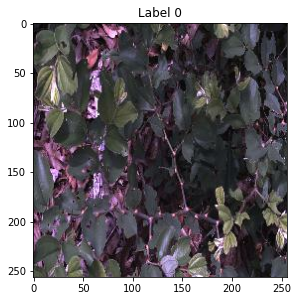

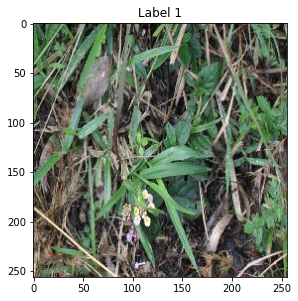

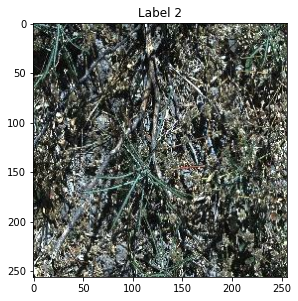

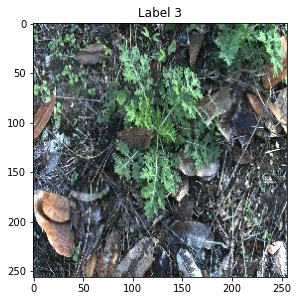

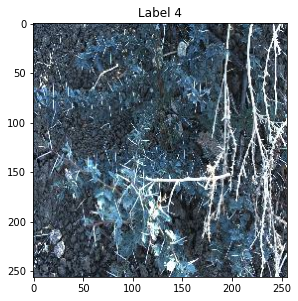

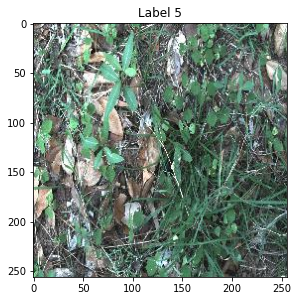

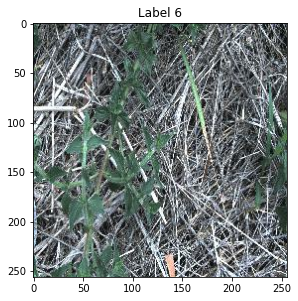

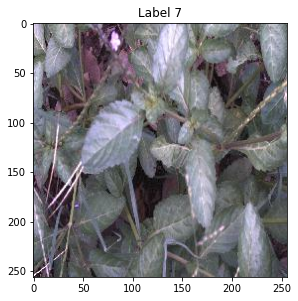

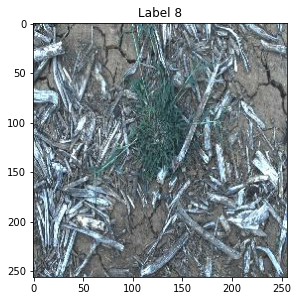

In [36]:
fig = plt.figure(figsize = (40,40))

for i in range(9):
    fig = plt.figure(figsize = (10,10))
    ax = fig.add_subplot(1,2,1)
    plt.imshow(img_sorted[i][np.random.randint(0,500)])
    ax.set_title(f"Label {i}")

# Feature Engineering

Properties of Images which will be extracted and analysed

1. Average RBG values
2. Average Intensity (Convert to greyscale)
3. Compare Histogram
4. Comparing Edge Pictures
5. Apply filters like the gaussian and take average after
6. Comparing Gradient images

In [7]:
img = images[0]

In [14]:
def normalize_img(img):
    return img/255

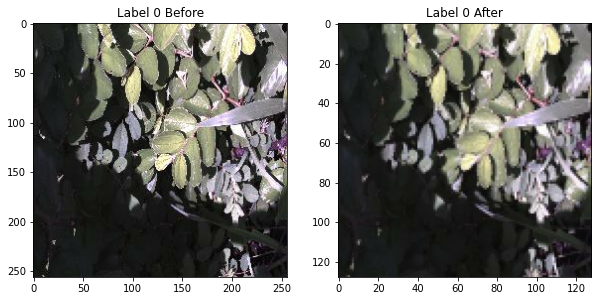

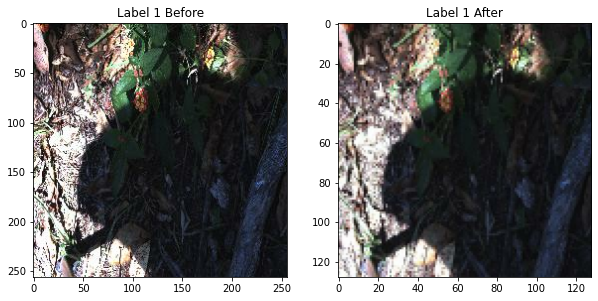

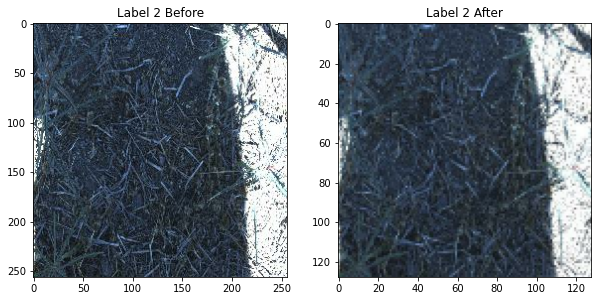

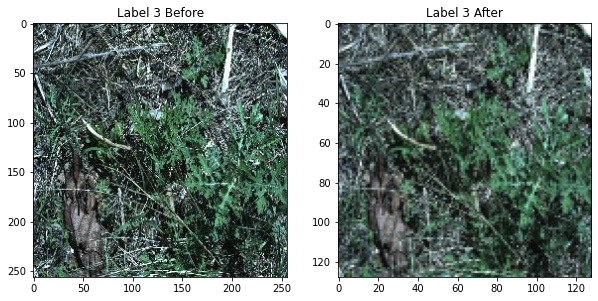

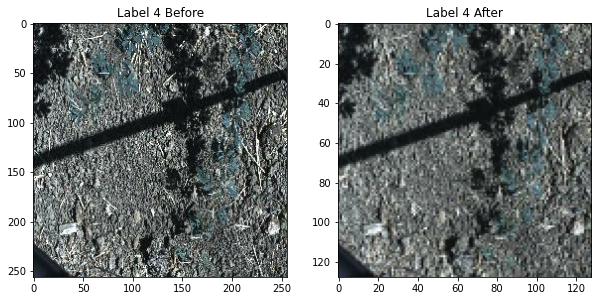

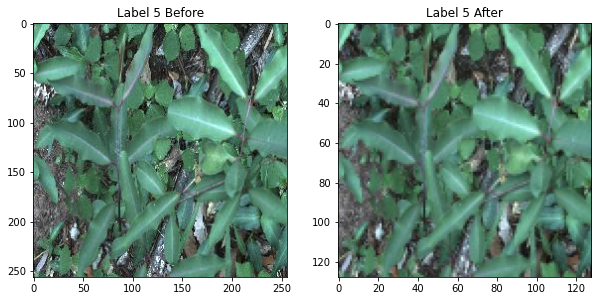

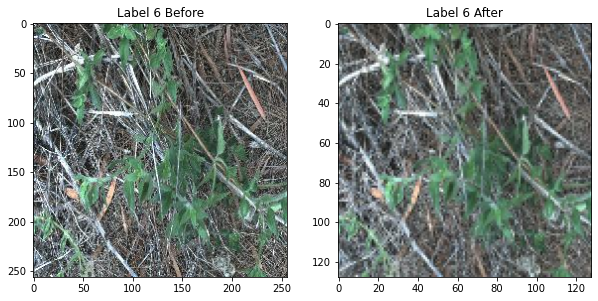

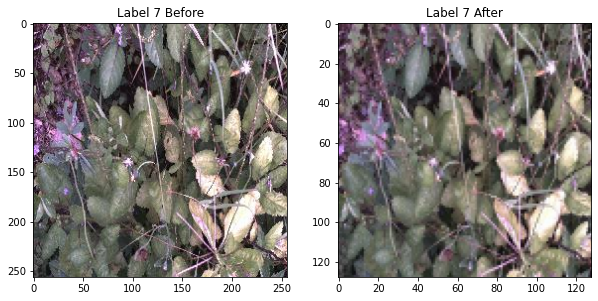

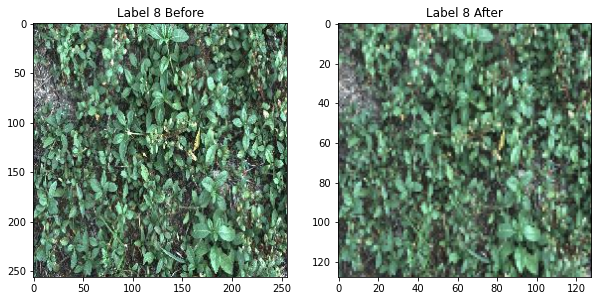

In [34]:
def re_size(img, new_size):
    return cv2.resize(img, new_size)

for i in range(len(img_sorted)):
    fig = plt.figure(figsize = (10,10))
    ax = fig.add_subplot(1,2,1)
    n = np.random.randint(0,500)
    plt.imshow(img_sorted[i][n])
    ax.set_title(f"Label {i} Before")

    ax = fig.add_subplot(1,2,2)
    plt.imshow(re_size(img_sorted[i][n].numpy(), (128,128)))
    ax.set_title(f"Label {i} After")

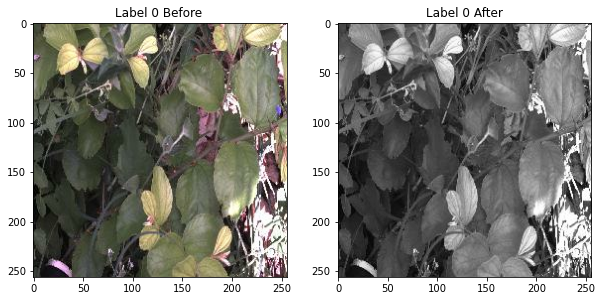

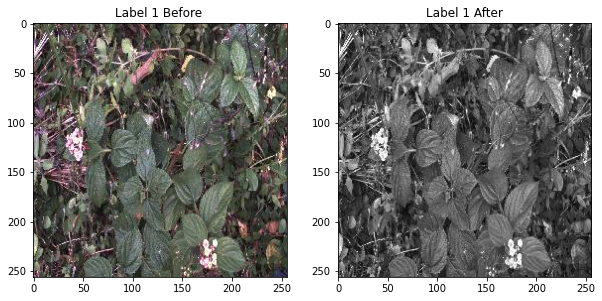

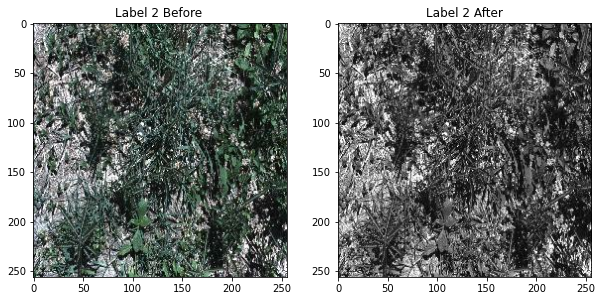

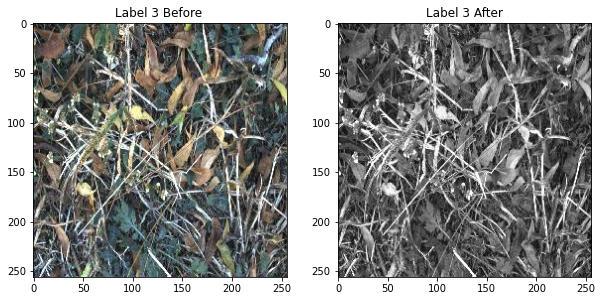

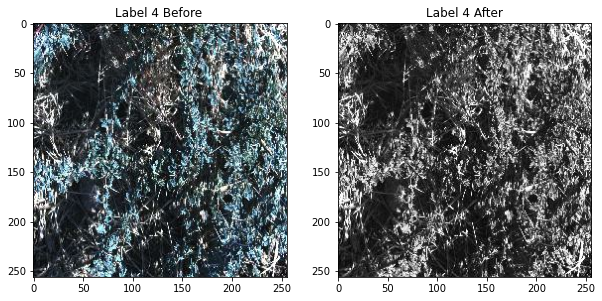

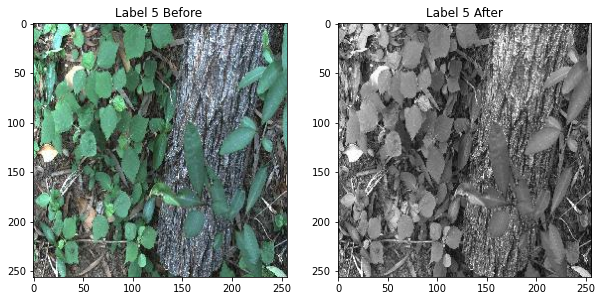

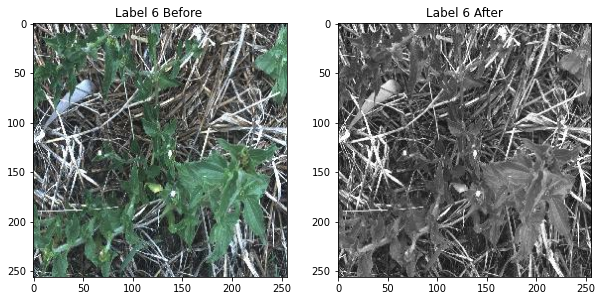

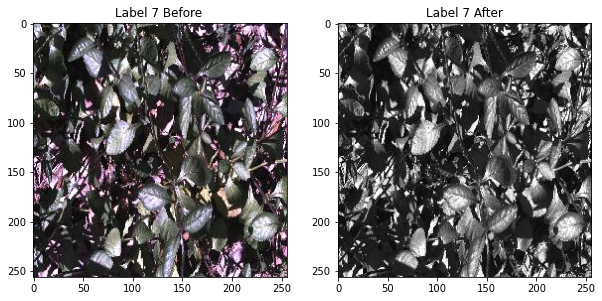

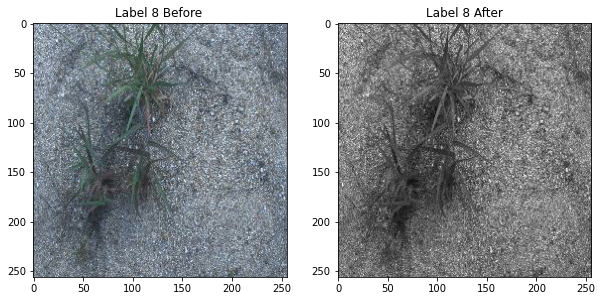

In [35]:
def conv_greyscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

for i in range(len(img_sorted)):
    fig = plt.figure(figsize = (10,10))
    ax = fig.add_subplot(1,2,1)
    n = np.random.randint(0,500)
    plt.imshow(img_sorted[i][n])
    ax.set_title(f"Label {i} Before ")



    ax = fig.add_subplot(1,2,2)
    plt.imshow(conv_greyscale(img_sorted[i][n].numpy()), cmap = 'gray')
    ax.set_title(f"Label {i} After")

# Pre Processing

## Histogram equalization

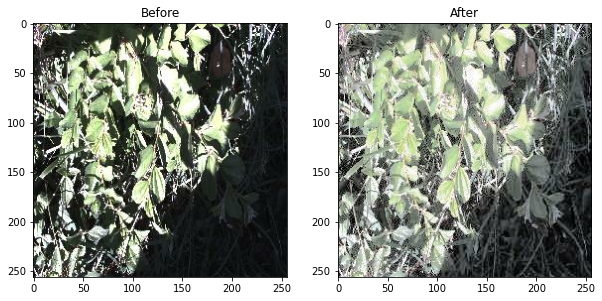

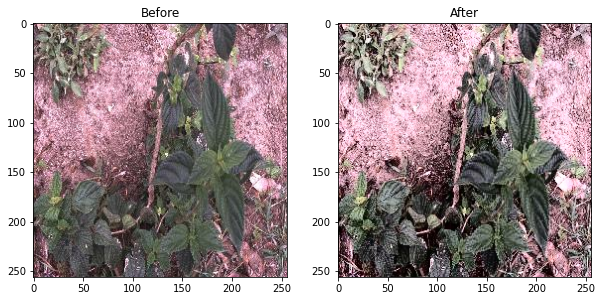

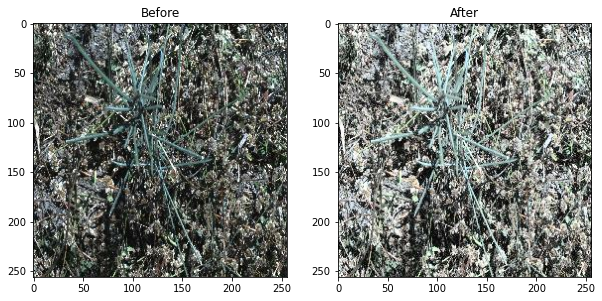

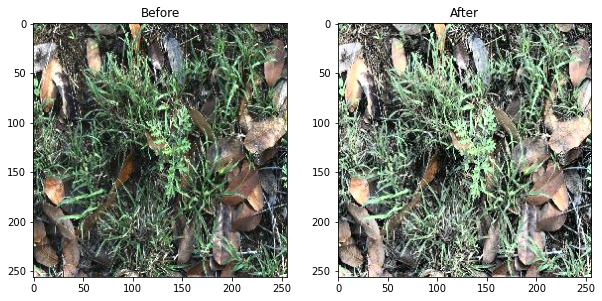

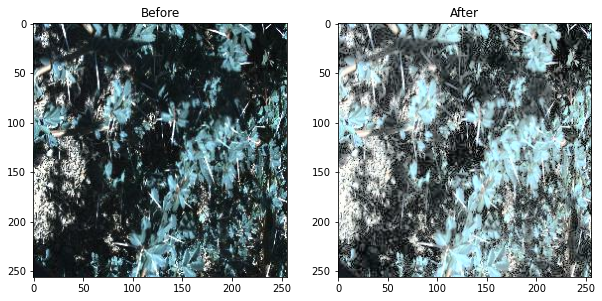

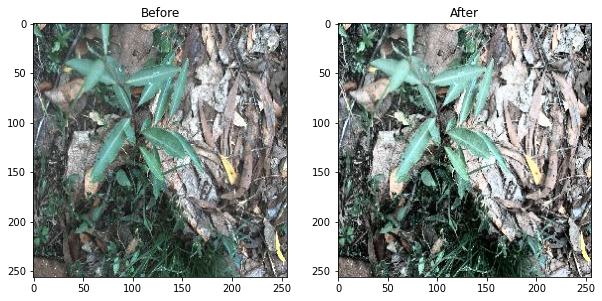

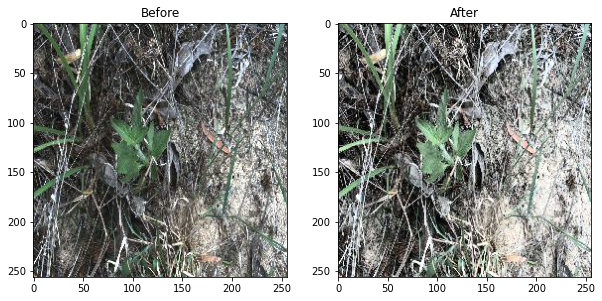

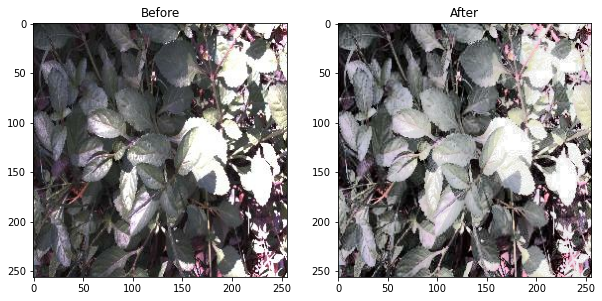

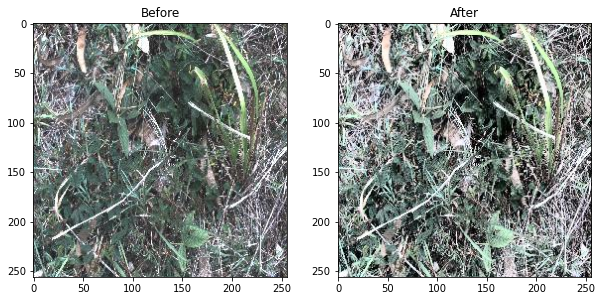

In [31]:
def histogram_equalization(img):
    img_yuv = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])
    img_output = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)
    return img_output

for i in range(len(img_sorted)):
    img = img_sorted[i][np.random.randint(0,500)].numpy()
    
    fig = plt.figure(figsize = (10,10))
    ax = fig.add_subplot(1,2,1)
    plt.imshow(img)
    ax.set_title("Before")

    img_output = histogram_equalization(img)

    ax = fig.add_subplot(1,2,2)
    plt.imshow(img_output)
    ax.set_title("After")

## Application of Different Blurs

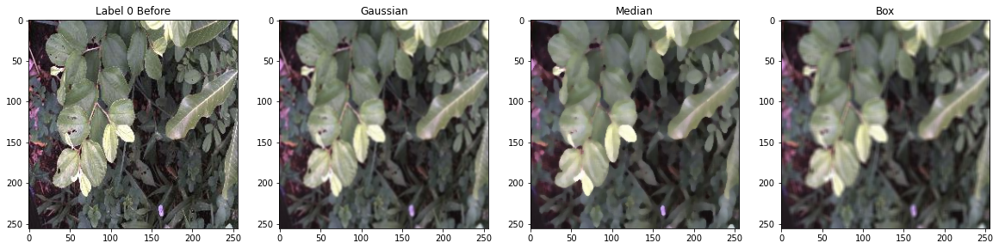

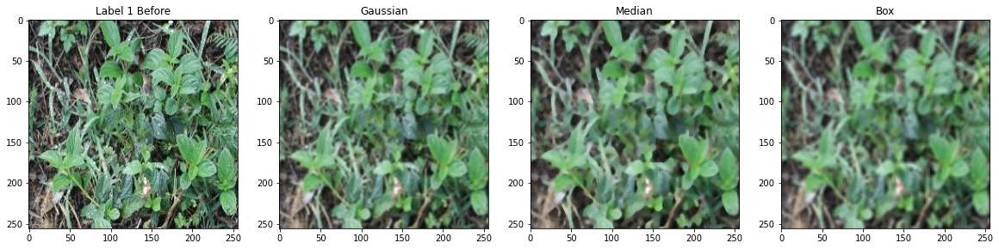

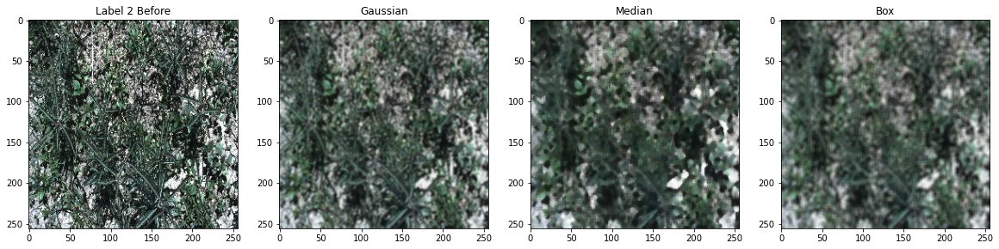

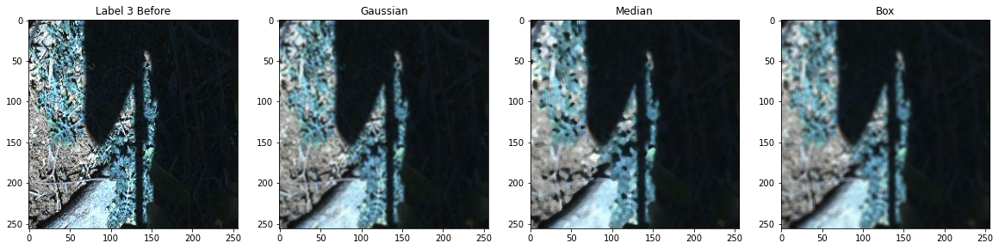

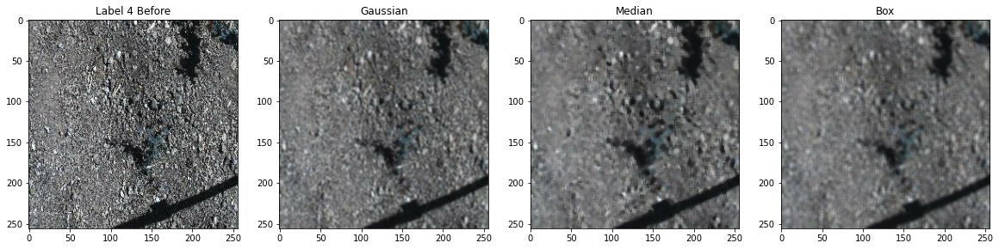

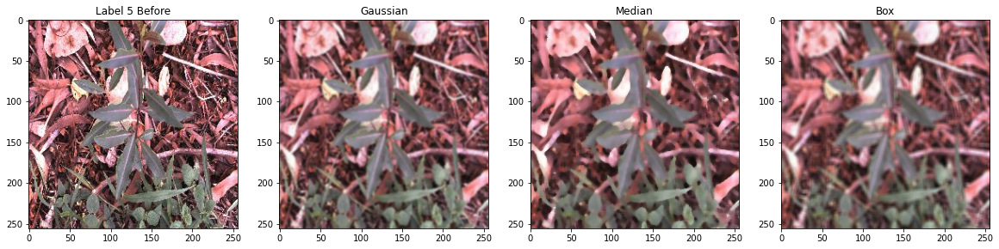

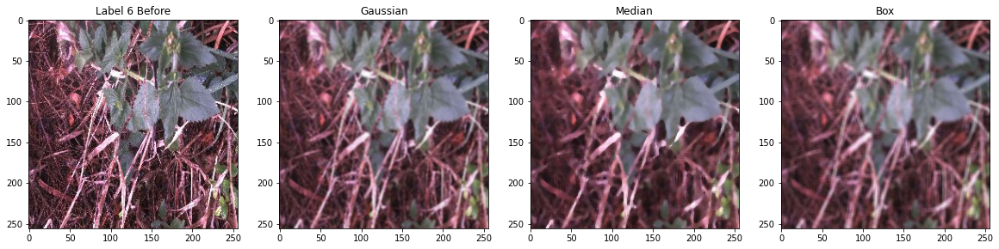

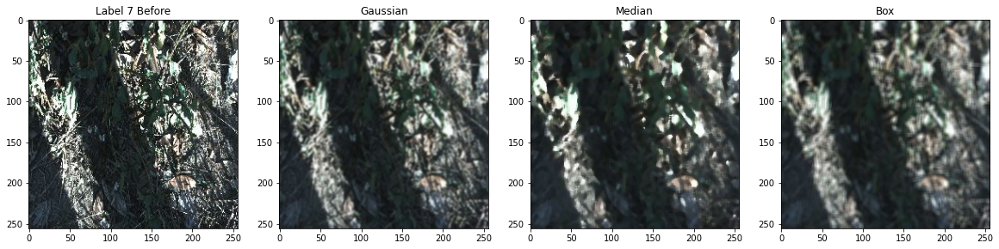

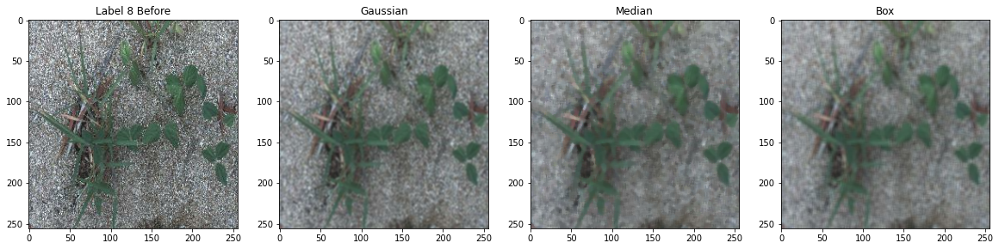

In [30]:
def gaussian_filter(img, kernel_size):
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def median_filter(img, kernel_size):
    return cv2.medianBlur(img, kernel_size)

def box_filter(img, kernel_size):
    return cv2.blur(img , (kernel_size, kernel_size))


for i in range(len(img_sorted)):
    img = img_sorted[i][np.random.randint(0,500)].numpy()
    fig = plt.figure(figsize = (20,20))
    ax = fig.add_subplot(1,4,1)
    plt.imshow(img)
    ax.set_title(f"Label {i} Before")
    
    gaussian = gaussian_filter(img, 5)
    median = median_filter(img , 5)
    box = box_filter(img , 5)
    
    
    ax = fig.add_subplot(1,4,2)
    plt.imshow(gaussian)
    ax.set_title("Gaussian")
    
    ax = fig.add_subplot(1,4,3)
    plt.imshow(median)
    ax.set_title("Median")
    
    ax = fig.add_subplot(1,4,4)
    plt.imshow(box)
    ax.set_title("Box")


## Gradient Images

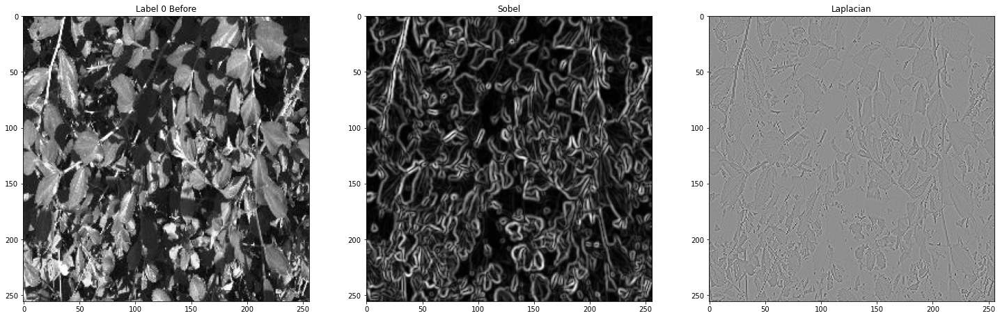

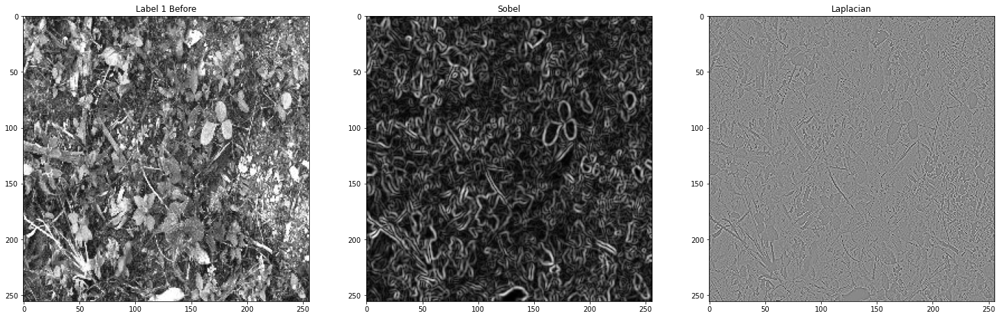

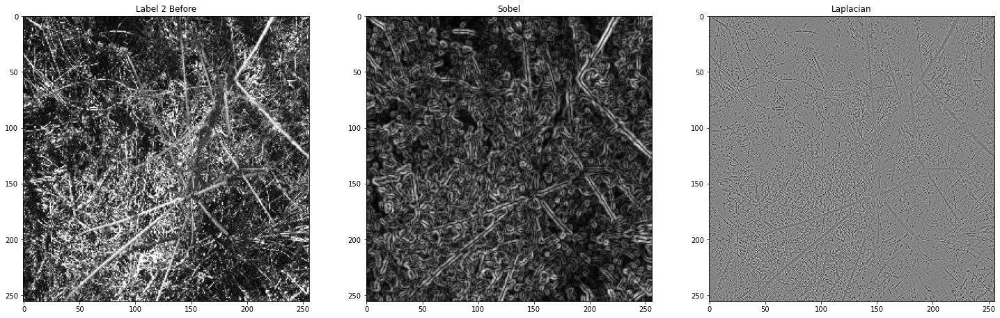

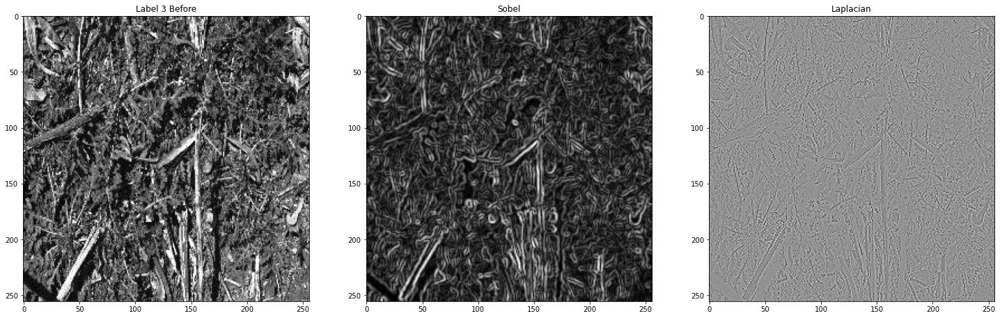

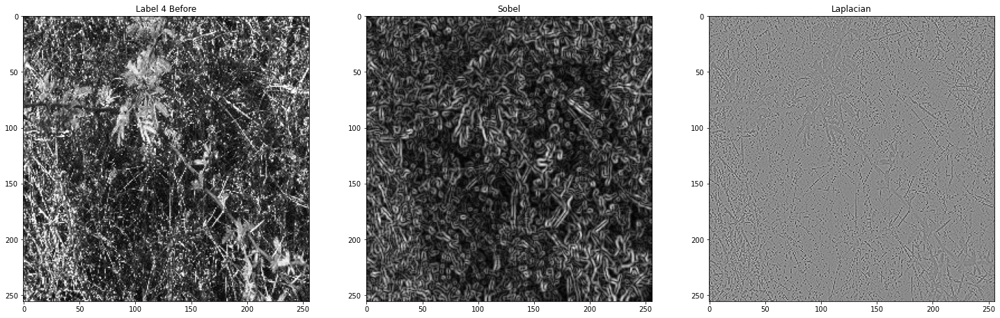

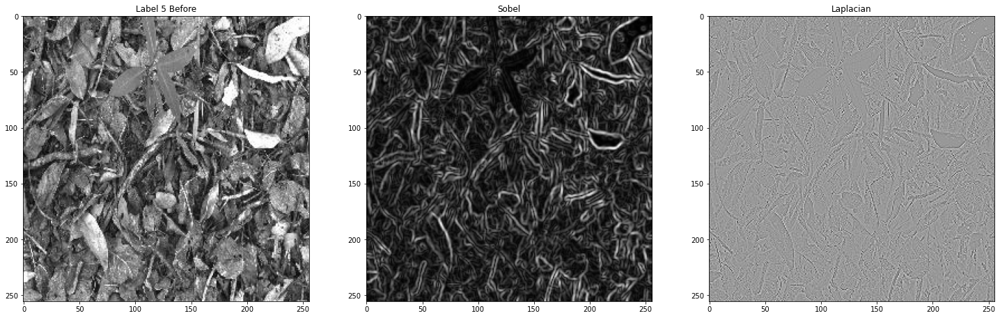

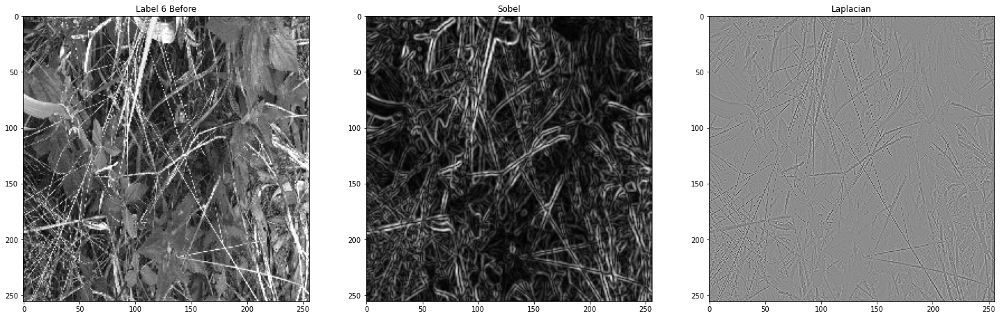

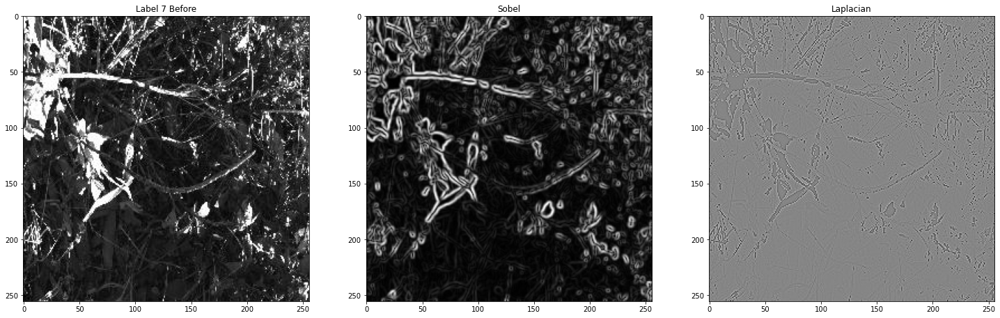

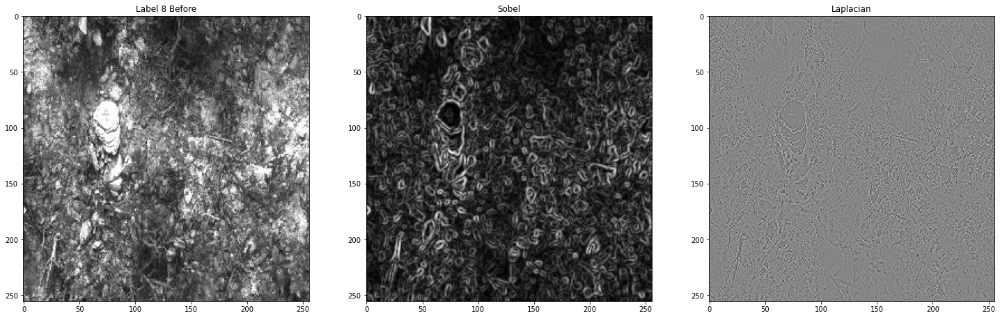

In [28]:
def sobel_filter(img, kernel_size):
    sobelx = cv2.Sobel(img, cv2.CV_64F,1,0, ksize = kernel_size)
    sobely = cv2.Sobel(img, cv2.CV_64F,0,1, ksize = kernel_size)
    sobel = np.sqrt(sobelx**2 + sobely**2)
    return sobel

def laplacian_filter(img):
    return cv2.Laplacian(img, cv2.CV_64F)

for i in range(len(img_sorted)):
    img = img_sorted[i][np.random.randint(0,500)].numpy()
    img = conv_greyscale(img)
    fig = plt.figure(figsize = (25,25))
    ax = fig.add_subplot(1,3,1)
    plt.imshow(img, cmap = 'gray')
    ax.set_title(f"Label {i} Before")
    
    sobel = sobel_filter(img, 5)
    laplacian = laplacian_filter(img)
    
    ax = fig.add_subplot(1,3,2)
    plt.imshow(sobel, cmap = 'gray')
    ax.set_title("Sobel")
    
    ax = fig.add_subplot(1,3,3)
    plt.imshow(laplacian, cmap = 'gray')
    ax.set_title("Laplacian")